In [47]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/wildlife-strikes/database.csv


In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import warnings
warnings.filterwarnings('ignore')

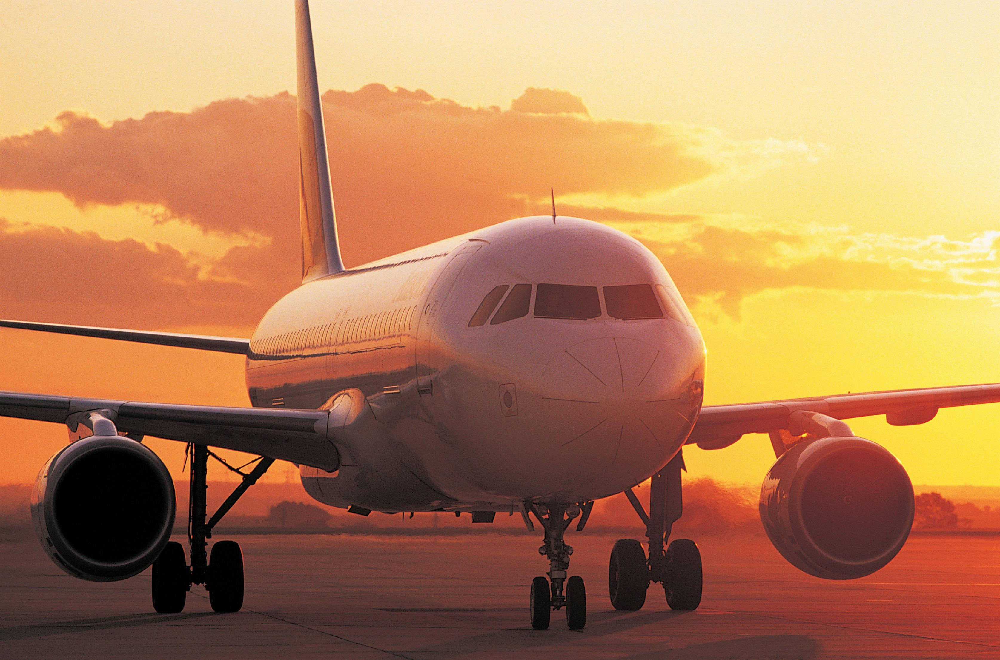


In [49]:
file_path = '/kaggle/input/wildlife-strikes/database.csv'

# Try to load the data
try:
    data = pd.read_csv(file_path, low_memory=False)
    print("Data loaded successfully")
except FileNotFoundError:
    print(f"File not found: {file_path}")
except pd.errors.EmptyDataError:
    print("No data: The file is empty")
except pd.errors.ParserError:
    print("Error parsing the file")
except Exception as e:
    print(f"An error occurred: {e}")

# Display the first few rows of the dataset if loaded successfully
if 'data' in locals():
    print(data.head())

Data loaded successfully
   Record ID  Incident Year  Incident Month  Incident Day Operator ID  \
0     127128           1990               1             1         DAL   
1     129779           1990               1             1         HAL   
2     129780           1990               1             2         UNK   
3       2258           1990               1             3         MIL   
4       2257           1990               1             3         MIL   

          Operator   Aircraft Aircraft Type Aircraft Make Aircraft Model  \
0  DELTA AIR LINES  B-757-200             A           148             26   
1     HAWAIIAN AIR       DC-9             A           583             90   
2          UNKNOWN    UNKNOWN           NaN           NaN            NaN   
3         MILITARY      A-10A             A           345            NaN   
4         MILITARY       F-16             A           561            NaN   

   Aircraft Mass  Engine Make Engine Model  Engines Engine Type  \
0           

In [50]:
data

,Record ID,Incident Year,Incident Month,Incident Day,Operator ID,Operator,Aircraft,Aircraft Type,Aircraft Make,Aircraft Model,Aircraft Mass,Engine Make,Engine Model,Engines,Engine Type,Engine1 Position,Engine2 Position,Engine3 Position,Engine4 Position,Airport ID,Airport,State,FAA Region,Warning Issued,Flight Phase,Visibility,Precipitation,Height,Speed,Distance,Species ID,Species Name,Species Quantity,Flight Impact,Fatalities,Injuries,Aircraft Damage,Radome Strike,Radome Damage,Windshield Strike,Windshield Damage,Nose Strike,Nose Damage,Engine1 Strike,Engine1 Damage,Engine2 Strike,Engine2 Damage,Engine3 Strike,Engine3 Damage,Engine4 Strike,Engine4 Damage,Engine Ingested,Propeller Strike,Propeller Damage,Wing or Rotor Strike,Wing or Rotor Damage,Fuselage Strike,Fuselage Damage,Landing Gear Strike,Landing Gear Damage,Tail Strike,Tail Damage,Lights Strike,Lights Damage,Other Strike,Other Damage
0,127128,1990,1,1,DAL,DELTA AIR LINES,B-757-200,A,148,26,4.0,34.0,40,2.0,D,1,1.0,NaN,NaN,KCVG,CINCINNATI/NORTHERN KENTUCKY INTL ARPT,KY,ASO,NaN,CLIMB,NaN,NaN,NaN,NaN,NaN,NE1,GULL,1,NaN,NaN,NaN,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0
1,129779,1990,1,1,HAL,HAWAIIAN AIR,DC-9,A,583,90,4.0,34.0,10,2.0,D,5,5.0,NaN,NaN,PHLI,LIHUE ARPT,HI,AWP,NaN,TAKEOFF RUN,NaN,NaN,0.0,NaN,0.0,ZZ201,HOUSE SPARROW,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,129780,1990,1,2,UNK,UNKNOWN,UNKNOWN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PHLI,LIHUE ARPT,HI,AWP,NaN,NaN,NaN,NaN,NaN,NaN,0.0,R1101,BARN OWL,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2258,1990,1,3,MIL,MILITARY,A-10A,A,345,NaN,3.0,22.0,NaN,2.0,D,NaN,NaN,NaN,NaN,KMYR,MYRTLE BEACH INTL,SC,ASO,NaN,APPROACH,DAY,NaN,200.0,138.0,NaN,UNKBM,UNKNOWN MEDIUM BIRD,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,2257,1990,1,3,MIL,MILITARY,F-16,A,561,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,KJAX,JACKSONVILLE INTL,FL,ASO,NaN,CLIMB,DAY,NaN,100.0,200.0,NaN,ZX,FINCH,1,NaN,NaN,NaN,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174099,366091,2015,9,30,SWA,SOUTHWEST AIRLINES,B-737-700,A,148,42,4.0,10.0,1,2.0,D,1,1.0,NaN,NaN,UNKN,NaN,NaN,NaN,N,NaN,NaN,NONE,NaN,NaN,NaN,UNKBS,UNKNOWN SMALL BIRD,1,NONE,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
174100,365902,2015,9,30,SWA,SOUTHWEST AIRLINES,B-737-700,A,148,42,4.0,10.0,1,2.0,D,1,1.0,NaN,NaN,KDAL,DALLAS LOVE FIELD ARPT,TX,ASW,N,APPROACH,DAY,NONE,5000.0,250.0,25.0,UNKBS,UNKNOWN SMALL BIRD,1,NONE,NaN,NaN,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
174101,365903,2015,9,30,BUS,BUSINESS,CITATIONJET,A,226,49,2.0,46.0,1,2.0,D,5,5.0,NaN,NaN,KMIA,MIAMI INTL,FL,ASO,NaN,CLIMB,DAY,NONE,3000.0,200.0,5.0,K1002,TURKEY VULTURE,1,NONE,NaN,NaN,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0
174102,366046,2015,9,30,QXE,HORIZON AIR,DHC8 DASH 8,A,303,10,3.0,31.0,10,2.0,C,4,4.0,NaN,NaN,KPDX,PORTLAND INTL (OR),OR,ANM,Y,DESCENT,NIGHT,NONE,6000.0,NaN,NaN,Z6014,HERMIT THRUSH,1,NONE,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [51]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174104 entries, 0 to 174103
Data columns (total 66 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Record ID             174104 non-null  int64  
 1   Incident Year         174104 non-null  int64  
 2   Incident Month        174104 non-null  int64  
 3   Incident Day          174104 non-null  int64  
 4   Operator ID           174104 non-null  object 
 5   Operator              174104 non-null  object 
 6   Aircraft              174104 non-null  object 
 7   Aircraft Type         133074 non-null  object 
 8   Aircraft Make         131051 non-null  object 
 9   Aircraft Model        122439 non-null  object 
 10  Aircraft Mass         127320 non-null  float64
 11  Engine Make           123434 non-null  float64
 12  Engine Model          121988 non-null  object 
 13  Engines               127342 non-null  float64
 14  Engine Type           127282 non-null  object 
 15  

In [52]:
data.isnull().sum()

Record ID         0
Incident Year     0
Incident Month    0
Incident Day      0
Operator ID       0
                 ..
Tail Damage       0
Lights Strike     0
Lights Damage     0
Other Strike      0
Other Damage      0
Length: 66, dtype: int64

In [53]:
pd.set_option('display.max_columns', None)
data


,Record ID,Incident Year,Incident Month,Incident Day,Operator ID,Operator,Aircraft,Aircraft Type,Aircraft Make,Aircraft Model,Aircraft Mass,Engine Make,Engine Model,Engines,Engine Type,Engine1 Position,Engine2 Position,Engine3 Position,Engine4 Position,Airport ID,Airport,State,FAA Region,Warning Issued,Flight Phase,Visibility,Precipitation,Height,Speed,Distance,Species ID,Species Name,Species Quantity,Flight Impact,Fatalities,Injuries,Aircraft Damage,Radome Strike,Radome Damage,Windshield Strike,Windshield Damage,Nose Strike,Nose Damage,Engine1 Strike,Engine1 Damage,Engine2 Strike,Engine2 Damage,Engine3 Strike,Engine3 Damage,Engine4 Strike,Engine4 Damage,Engine Ingested,Propeller Strike,Propeller Damage,Wing or Rotor Strike,Wing or Rotor Damage,Fuselage Strike,Fuselage Damage,Landing Gear Strike,Landing Gear Damage,Tail Strike,Tail Damage,Lights Strike,Lights Damage,Other Strike,Other Damage
0,127128,1990,1,1,DAL,DELTA AIR LINES,B-757-200,A,148,26,4.0,34.0,40,2.0,D,1,1.0,NaN,NaN,KCVG,CINCINNATI/NORTHERN KENTUCKY INTL ARPT,KY,ASO,NaN,CLIMB,NaN,NaN,NaN,NaN,NaN,NE1,GULL,1,NaN,NaN,NaN,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0
1,129779,1990,1,1,HAL,HAWAIIAN AIR,DC-9,A,583,90,4.0,34.0,10,2.0,D,5,5.0,NaN,NaN,PHLI,LIHUE ARPT,HI,AWP,NaN,TAKEOFF RUN,NaN,NaN,0.0,NaN,0.0,ZZ201,HOUSE SPARROW,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,129780,1990,1,2,UNK,UNKNOWN,UNKNOWN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PHLI,LIHUE ARPT,HI,AWP,NaN,NaN,NaN,NaN,NaN,NaN,0.0,R1101,BARN OWL,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2258,1990,1,3,MIL,MILITARY,A-10A,A,345,NaN,3.0,22.0,NaN,2.0,D,NaN,NaN,NaN,NaN,KMYR,MYRTLE BEACH INTL,SC,ASO,NaN,APPROACH,DAY,NaN,200.0,138.0,NaN,UNKBM,UNKNOWN MEDIUM BIRD,1,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,2257,1990,1,3,MIL,MILITARY,F-16,A,561,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,KJAX,JACKSONVILLE INTL,FL,ASO,NaN,CLIMB,DAY,NaN,100.0,200.0,NaN,ZX,FINCH,1,NaN,NaN,NaN,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174099,366091,2015,9,30,SWA,SOUTHWEST AIRLINES,B-737-700,A,148,42,4.0,10.0,1,2.0,D,1,1.0,NaN,NaN,UNKN,NaN,NaN,NaN,N,NaN,NaN,NONE,NaN,NaN,NaN,UNKBS,UNKNOWN SMALL BIRD,1,NONE,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
174100,365902,2015,9,30,SWA,SOUTHWEST AIRLINES,B-737-700,A,148,42,4.0,10.0,1,2.0,D,1,1.0,NaN,NaN,KDAL,DALLAS LOVE FIELD ARPT,TX,ASW,N,APPROACH,DAY,NONE,5000.0,250.0,25.0,UNKBS,UNKNOWN SMALL BIRD,1,NONE,NaN,NaN,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
174101,365903,2015,9,30,BUS,BUSINESS,CITATIONJET,A,226,49,2.0,46.0,1,2.0,D,5,5.0,NaN,NaN,KMIA,MIAMI INTL,FL,ASO,NaN,CLIMB,DAY,NONE,3000.0,200.0,5.0,K1002,TURKEY VULTURE,1,NONE,NaN,NaN,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0
174102,366046,2015,9,30,QXE,HORIZON AIR,DHC8 DASH 8,A,303,10,3.0,31.0,10,2.0,C,4,4.0,NaN,NaN,KPDX,PORTLAND INTL (OR),OR,ANM,Y,DESCENT,NIGHT,NONE,6000.0,NaN,NaN,Z6014,HERMIT THRUSH,1,NONE,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [54]:
important = data.drop(columns=["Record ID", "Incident Month", "Incident Day", "Operator ID", "Aircraft Type" , "Aircraft Make" , "Aircraft Model", "Aircraft Mass" , "Engine Make" , "Engine Model" , "Engines" , "Engine Type" , "Engine1 Position" , "Engine2 Position"  , "Engine3 Position" , "Engine4 Position" , "Airport ID" , "Airport" , "Fuselage Strike" , "Fuselage Damage" , "Landing Gear Strike" , "Landing Gear Damage" , "Tail Strike" , "Tail Damage" , "Lights Strike" , "Lights Damage" , "Other Strike" , "Other Damage" , "FAA Region" , "Warning Issued" , "Flight Phase" , "Visibility" , "Precipitation" , "Height" , "Engine3 Strike" , "Engine3 Damage" , "Engine4 Strike" , "Engine4 Damage" , "Engine Ingested" , "Propeller Strike" , "Propeller Damage" , "Wing or Rotor Strike" , "Wing or Rotor Damage" , "Radome Strike" , "Radome Damage" , "Windshield Strike" , "Windshield Damage" , "Nose Strike" , "Nose Damage" , "Engine1 Strike" , "Engine1 Damage" , "Engine2 Strike" , "Engine2 Damage" , "Speed" , "Distance" , "Species ID" , "Species Quantity" , "Flight Impact", "Fatalities", "Injuries"])
important 

,Incident Year,Operator,Aircraft,State,Species Name,Aircraft Damage
0,1990,DELTA AIR LINES,B-757-200,KY,GULL,1
1,1990,HAWAIIAN AIR,DC-9,HI,HOUSE SPARROW,0
2,1990,UNKNOWN,UNKNOWN,HI,BARN OWL,0
3,1990,MILITARY,A-10A,SC,UNKNOWN MEDIUM BIRD,0
4,1990,MILITARY,F-16,FL,FINCH,0
...,...,...,...,...,...,...
174099,2015,SOUTHWEST AIRLINES,B-737-700,NaN,UNKNOWN SMALL BIRD,0
174100,2015,SOUTHWEST AIRLINES,B-737-700,TX,UNKNOWN SMALL BIRD,0
174101,2015,BUSINESS,CITATIONJET,FL,TURKEY VULTURE,1
174102,2015,HORIZON AIR,DHC8 DASH 8,OR,HERMIT THRUSH,0


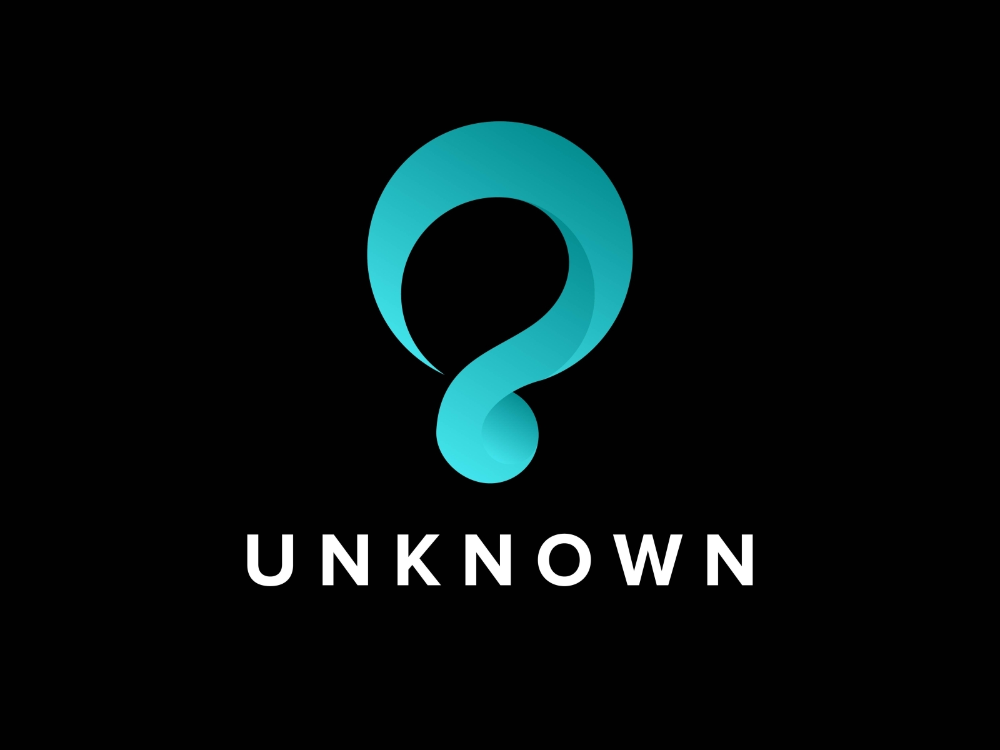


After Reviewing the data excluding the unknown for better understanding to which bird or type of Flight is prone to accidents.

In [55]:
# For Check Between Known and Unknown Parameters
important = important.loc[important["Aircraft"] != "UNKNOWN"]
important = important.loc[important["Operator"] != "UNKNOWN"]
important = important.loc[important["Species Name"] != "UNKNOWN BIRD"]
important = important.loc[important["Species Name"] != "UNKNOWN MEDIUM BIRD"]
important = important.loc[important["Species Name"] != "UNKNOWN SMALL BIRD"]
important = important.loc[important["Species Name"] != "UNKNOWN BIRD OR BAT"]
important

,Incident Year,Operator,Aircraft,State,Species Name,Aircraft Damage
0,1990,DELTA AIR LINES,B-757-200,KY,GULL,1
1,1990,HAWAIIAN AIR,DC-9,HI,HOUSE SPARROW,0
4,1990,MILITARY,F-16,FL,FINCH,0
5,1990,HAWAIIAN AIR,DC-9,HI,MUNIAS,0
10,1990,1US AIRWAYS,B-737-200,FL,GULL,0
...,...,...,...,...,...,...
174095,2015,BUSINESS,EC130,NaN,HAWK,0
174097,2015,EXPRESSJET AIRLINES,EMB-135,NY,GULL,0
174101,2015,BUSINESS,CITATIONJET,FL,TURKEY VULTURE,1
174102,2015,HORIZON AIR,DHC8 DASH 8,OR,HERMIT THRUSH,0


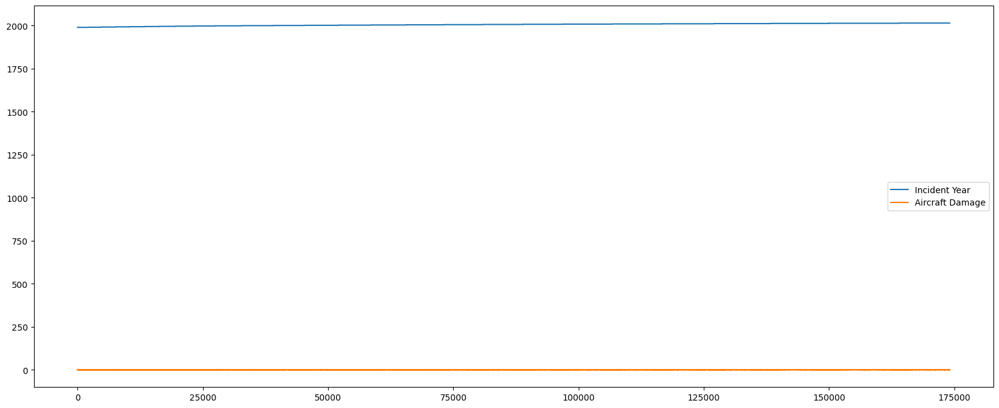

In [56]:
important.plot.line()
plt.show()

In [57]:
#Label Encoding
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
le = LabelEncoder()


In [58]:
important['Aircraft'] = le.fit_transform(important['Aircraft'])
important['Operator'] = le.fit_transform(important['Operator'])
important['State'] = le.fit_transform(important['State'])
important['Species Name'] = le.fit_transform(important['Species Name'])


In [59]:
important

,Incident Year,Operator,Aircraft,State,Species Name,Aircraft Damage
0,1990,167,68,19,260,1
1,1990,235,284,13,290,0
4,1990,297,340,11,212,0
5,1990,235,284,13,364,0
10,1990,0,54,11,260,0
...,...,...,...,...,...,...
174095,2015,111,310,62,272,0
174097,2015,201,323,39,260,0
174101,2015,111,249,11,551,1
174102,2015,239,293,43,275,0


In [60]:
x=important.iloc[:,:-1].values
y=important.iloc[:,-1].values

In [61]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.4,random_state=42)

In [62]:
logreg = LogisticRegression()

In [63]:
logreg.fit(x_train, y_train)

LogisticRegression()

In [64]:
y_pred = logreg.predict(x_test)

In [65]:
accuracy = round(accuracy_score(y_test, y_pred)*100,2)
print(f'Accuracy: {accuracy}%')

Accuracy: 83.78%


In [66]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

In [67]:
nn = KNeighborsClassifier(n_neighbors=10)

dt = DecisionTreeClassifier(max_depth=3)

rf = RandomForestClassifier(max_depth=3, n_estimators=500)

ada = AdaBoostClassifier(n_estimators=50, learning_rate=0.01)

gbr = GradientBoostingClassifier(max_depth=2, n_estimators=100, learning_rate=0.2)

xgb = XGBClassifier(max_depth=3, n_estimators=50, learning_rate=0.2)

cb = CatBoostClassifier(learning_rate=0.01, max_depth=5, verbose=0)



# List of classifiers
classifiers = [
        ('K Nearest Neighbours', nn),
    ('Decision Tree', dt),
    ('Random Forest', rf),
    ('AdaBoost', ada),
    ('Gradient Boosting Classifier', gbr),
    ('XGBoost', xgb),
    ('CatBoost', cb)
]

K Nearest Neighbours : 85 %
Decision Tree : 85 %
Random Forest : 84 %
AdaBoost : 84 %
Gradient Boosting Classifier : 86 %
XGBoost : 86 %
CatBoost : 86 %


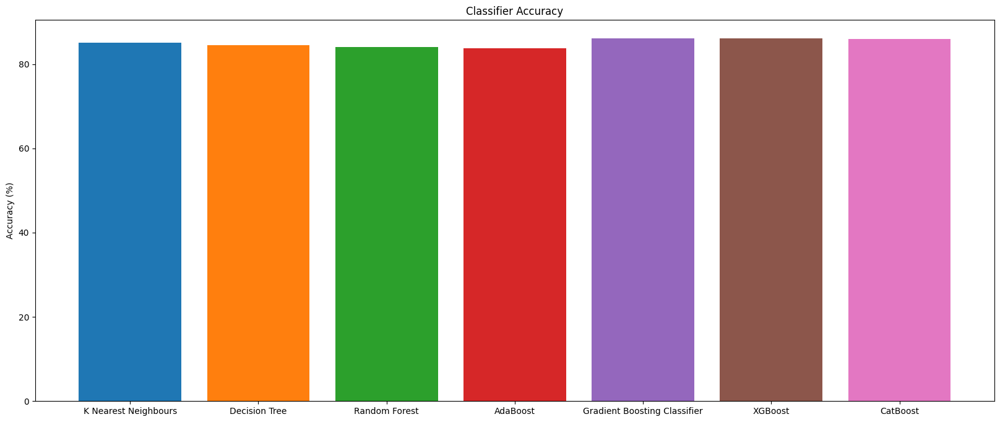

In [68]:
#Boosters
from sklearn.metrics import accuracy_score


# Assuming you have defined your classifiers as `classifiers` from the previous code

for classifier_name, classifier in classifiers:
    # Fit classifier to the training set
    classifier.fit(x_train, y_train)
   
    # Predict
    y_pred = classifier.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred) * 100
    
    # Evaluate accuracy on the test set
    print('{:s} : {:.0f} %'.format(classifier_name, accuracy))
    
    # Plotting accuracy
    plt.rcParams["figure.figsize"] = (20, 8)
    plt.bar(classifier_name, accuracy)

# Show plot
plt.ylabel('Accuracy (%)')
plt.title('Classifier Accuracy')
plt.show()

# ANN


Epoch 1/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 0.7866 - loss: 11.5659 - val_accuracy: 0.8407 - val_loss: 0.5909
Epoch 2/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8058 - loss: 0.5559 - val_accuracy: 0.8407 - val_loss: 0.6287
Epoch 3/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8177 - loss: 0.5108 - val_accuracy: 0.8407 - val_loss: 0.5443
Epoch 4/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8091 - loss: 0.5382 - val_accuracy: 0.8407 - val_loss: 0.6384
Epoch 5/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8095 - loss: 0.5331 - val_accuracy: 0.8407 - val_loss: 0.5980
Epoch 6/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8254 - loss: 0.4996 - val_accuracy: 0.7322 - val_loss: 0.5656
Epoch 7/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8157 - loss: 0.5212 - val_accuracy: 0.8407 - val_loss: 0.4416
Epoch 8/50
963/963 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.8213 - loss: 0.5075 - val_accuracy: 0

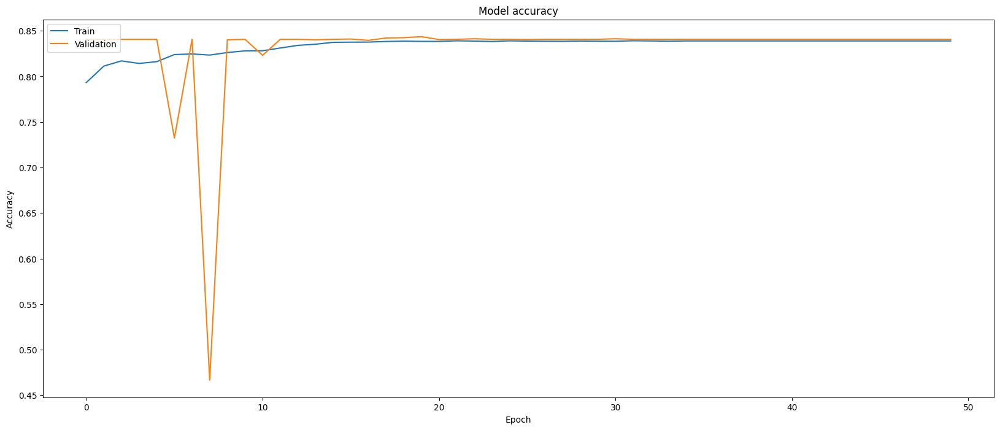

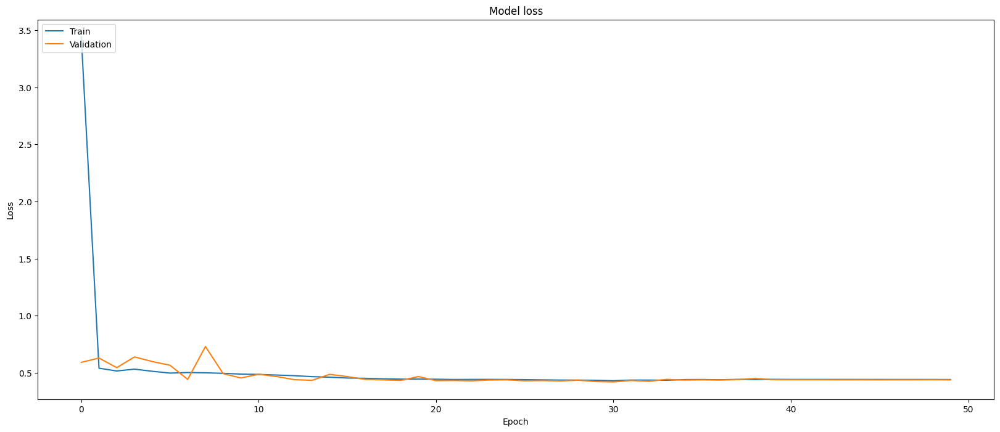

In [69]:
model = Sequential()

# Adding the input layer and the first hidden layer
model.add(Dense(units=16, activation='relu', input_dim=x_train.shape[1]))

# Adding the second hidden layer
model.add(Dense(units=16, activation='relu'))

# Adding the output layer
model.add(Dense(units=1, activation='sigmoid'))  # Use 'softmax' for multi-class classification

# Compile the Model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the Model
history = model.fit(x_train, y_train, epochs=50, batch_size=32, validation_split=0.1)

# Predicting the Test set results
y_pred = model.predict(x_test)
y_pred = (y_pred > 0.5)

# Calculate the accuracy
accuracy = accuracy_score(y_test, y_pred) * 100
print(f'Accuracy: {accuracy:.2f} %')

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()